# German restaurants in New York

## Background and Motivation
*Clearly define a problem or an idea of your choice, where you would need to leverage the Foursquare location data to solve or execute. Remember that data science problems always target an audience and are meant to help a group of stakeholders solve a problem, so make sure that you explicitly describe your audience and why they would care about your problem.*

New York is said to be one of the most exciting cities in the world. Within an area of around 300 square miles live 8.40 million people making New York also one of the most crowded places in the US. Being the dream destination for immigrants from all over the globe, New York is having an almost infinite number of restaurants serving every cuisine one can image. Even though an overall GMP of about two trillion US dollars seems like a huge potential for businesses, the market in New York is already fairly saturated and high real estate prices leave no space for the weak, at least not in the hot spots of the city where the money lies.  

For a group of investors I analyze the restaurant scene in the city "that never sleeps" to check the potential for a new German restaurant and get a first idea of what would be potential locations for such a restaurant where it would not hit too much direct competition. 

## Data and Methods
*Describe the data that you will be using to solve the problem or execute your idea. Remember
that you will need to use the Foursquare location data to solve the problem or execute your
idea. You can absolutely use other datasets in combination with the Foursquare location data.
So make sure that you provide adequate explanation and discussion, with examples, of the
data that you will be using, even if it is only Foursquare location data.*

I will join dataset with the geo coordinates of neighborhoods and boroughs in New York with venue data from Foursquare to analyze the competition in New York: 

1. City data: https://geo.nyu.edu/catalog/nyu_2451_34572
Geo coordinates to locate the boroughs and neighborhoods in New York City.

2. Datasource: Geopy
I use the geopy package to obtain the latitude and longitude values of New York City for maps.

3. Datasource: Foursquare API
The Foursquare API is utilized to obtain the locations and categories of food venues in New York. 

I will use the above mentioned data sources for maps and exploratory data analysis to give an overview over the competition and to identify potential spots for a new German restaurant in New York. 

## Data analysis and results
### Preparation and data wrangling
#### The basics: New York Neighborhoods
To get started, I first need a dataset that contains the basic information about New York, the coordinates of the neighborhoods in New York that I want to check for the best place to open a new German restaurant. 

In [1]:
# Install necessary packages if necessary
#!conda install -c conda-forge geopy --yes # uncomment this line if necessary
#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if necessary

# Import necessary packages
import numpy as np
import pandas as pd
import requests
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.io.json import json_normalize
import matplotlib.cm as cm
import matplotlib.colors as colors
from sklearn.cluster import KMeans
from sklearn.datasets.samples_generator import make_blobs
import lxml
import json
import wget
from geopy.geocoders import Nominatim
from bs4 import BeautifulSoup
import folium
print('Libraries imported.')

/opt/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.datasets.samples_generator module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.datasets. Anything that cannot be imported from sklearn.datasets is now part of the private API.
  warnings.warn(message, FutureWarning)


Libraries imported.


New York has a total of 5 boroughs and 306 neighborhoods. In order to identify those neighborhoods in the Foursquare database later, I need a a data set that contains the 5 boroughs and the neighborhoods in them together with the geodata (latitude and logitude coordinates). I download a GEOJSON file with the information from the website https://geo.nyu.edu/catalog/nyu_2451_34572.

The relevant information in the GEOJSON file is a list of the neighborhoods in New York. The informaiton is stored in the *features* key. To transfer that information in a Pandas dataframe for the data analysis, I first store the information in a variable. 



In [2]:
!wget -q -O 'newyork_data.json' https://cocl.us/new_york_dataset
print('Data downloaded!')

with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

    neighborhoods_data = newyork_data['features']
display(neighborhoods_data[0])

Data downloaded!


{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

In the next step I simply transfer the variable into a pandas dataframe. 

In [3]:
# Definition of the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude']

# Creating an empty dataframe
neighborhoods = pd.DataFrame(columns=column_names)

# Filling the dataframe row by row
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

# Check the dataframe
display(neighborhoods.head())
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
    len(neighborhoods['Borough'].unique()),
    neighborhoods.shape[0]))

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


The dataframe has 5 boroughs and 306 neighborhoods.


Now that I have a complete list of the neighborhoods in New York, let's have a look at a map of the city and the neighborhoods in it. 

In [4]:
# Get the geographical coordinates of New York. 
address = 'New York City, NY'
geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
ny_latitude = location.latitude
ny_longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(ny_latitude, ny_longitude))

# Create a map of New York
map_newyork = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Borough'], neighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


#### Adding location data using the Foursquare Places API
To understand the competition in New York, I add the location of restaurants to the dataset. 

In [5]:
# Define the Foursquare credentials

CLIENT_ID = 'AHMWCTGMOTR4AT1EGAYGJLAPUPBDDL1QUOK5RA4BQLNONKU3' # your Foursquare ID
CLIENT_SECRET = '4EPIVL5APO5PAZGJCWRCYHD24S5M1JBWDVS4U52H43ESB3H1' # your Foursquare Secret
VERSION = '20200605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: AHMWCTGMOTR4AT1EGAYGJLAPUPBDDL1QUOK5RA4BQLNONKU3
CLIENT_SECRET:4EPIVL5APO5PAZGJCWRCYHD24S5M1JBWDVS4U52H43ESB3H1


In [6]:
# Define a function to get information of food venues for all neighborhoods 
# I use the explore query to get a list of the top 100 food venues in a 500m radius around for each neighborhood
# Function for all nearby food venues
def getNearbyVenues(names, latitudes, longitudes, radius=500, LIMIT=100, section="food"):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&section={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            section)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [7]:
# Run the function to collect the information for food venues from Foursquare Places API
NY_venues = getNearbyVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude']
                                  )

display(NY_venues.shape)
display(NY_venues.head())
display(NY_venues.groupby('Neighborhood').count())
print('There are {} different types of food venues.'.format(len(NY_venues['Venue Category'].unique())))

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

(8052, 7)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Dunkin',40.890459,-73.849089,Donut Shop
1,Wakefield,40.894705,-73.847201,Subway,40.890468,-73.849152,Sandwich Place
2,Wakefield,40.894705,-73.847201,Pitman Deli,40.894149,-73.845748,Food
3,Wakefield,40.894705,-73.847201,Central Deli,40.896728,-73.844387,Deli / Bodega
4,Wakefield,40.894705,-73.847201,Louis Pizza,40.898399,-73.848810,Pizza Place


,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Allerton,23,23,23,23,23,23
Annadale,15,15,15,15,15,15
Arden Heights,2,2,2,2,2,2
Arlington,5,5,5,5,5,5
Arrochar,14,14,14,14,14,14
...,...,...,...,...,...,...
Woodhaven,23,23,23,23,23,23
Woodlawn,15,15,15,15,15,15
Woodrow,10,10,10,10,10,10


There are 136 different types of food venues.


In [8]:
# Function for nearby German restaurants venues
def getNearbyGerVenues(names, latitudes, longitudes, radius=500, LIMIT=100, categoryId="4bf58dd8d48988d10d941735"):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            categoryId)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_ger_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_ger_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_ger_venues)

In [9]:
# Run the function to collect the information for German restaurants from Foursquare Places API
NY_ger_venues = getNearbyGerVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude']
                                  )

display(NY_ger_venues.shape)
display(NY_ger_venues.head())
display(NY_ger_venues.groupby('Neighborhood').count())
print('There are {} different types of German restaurants.'.format(len(NY_ger_venues['Venue Category'].unique())))

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

(110, 7)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Kingsbridge,40.881687,-73.902818,Riverdale Diner,40.885183,-73.899484,Diner
1,Port Morris,40.801664,-73.913221,Schnitzel And Things,40.801616,-73.911046,German Restaurant
2,Parkchester,40.837938,-73.856003,Hoy Se Bebe!,40.840060,-73.860643,German Restaurant
3,Bay Ridge,40.625801,-74.030621,German House,40.623078,-74.031461,German Restaurant
4,Greenpoint,40.730201,-73.954241,Karczma,40.730102,-73.955092,Polish Restaurant


,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Astoria,1,1,1,1,1,1
Bath Beach,1,1,1,1,1,1
Battery Park City,1,1,1,1,1,1
Bay Ridge,1,1,1,1,1,1
Bedford Stuyvesant,1,1,1,1,1,1
Carnegie Hill,1,1,1,1,1,1
Carroll Gardens,1,1,1,1,1,1
Chelsea,5,5,5,5,5,5
Civic Center,2,2,2,2,2,2


There are 30 different types of German restaurants.


In [10]:
#Create a pandas dataframe that contains aggregated information for each neighborhood

# Calculting the total number of food places and merge with the dataset using neighborhood as indicator
No_of_food = NY_venues.groupby('Neighborhood').count()
No_of_food = No_of_food.drop(columns=['Neighborhood Longitude', 'Neighborhood Latitude', 'Venue Latitude', 'Venue Longitude', 'Venue Category'])
No_of_food.rename(columns={"Venue" : "Food venues total"}, inplace=True)
display(No_of_food)

No_of_german = NY_ger_venues.groupby('Neighborhood').count()
No_of_german = No_of_german.drop(columns=['Neighborhood Longitude', 'Neighborhood Latitude', 'Venue Latitude', 'Venue Longitude', 'Venue Category'])
No_of_german.rename(columns={"Venue" : "German restaurants"}, inplace=True)
display(No_of_german)

#Creating a new dataframe using the neighborhoods dataframe as a basis
df_results = neighborhoods 
df_results=df_results.set_index('Neighborhood')
df_results.head()
df_results.shape

df_results2 = df_results.join(No_of_food, on='Neighborhood')
df_results3 = df_results2.join(No_of_german, on='Neighborhood')

df_results3['Food venues total'].fillna(0, inplace=True)
df_results3['German restaurants'].fillna(0, inplace=True)

df_results3['Perc. German restaurants'] = (df_results3["German restaurants"]/df_results3["Food venues total"])

display(df_results3.head())
print(df_results3.shape)




,Food venues total
Neighborhood,
Allerton,23
Annadale,15
Arden Heights,2
Arlington,5
Arrochar,14
...,...
Woodhaven,23
Woodlawn,15
Woodrow,10


,German restaurants
Neighborhood,
Astoria,1
Bath Beach,1
Battery Park City,1
Bay Ridge,1
Bedford Stuyvesant,1
Carnegie Hill,1
Carroll Gardens,1
Chelsea,5
Civic Center,2


,Borough,Latitude,Longitude,Food venues total,German restaurants,Perc. German restaurants
Neighborhood,,,,,,
Wakefield,Bronx,40.894705,-73.847201,5.0,0.0,0.0
Co-op City,Bronx,40.874294,-73.829939,12.0,0.0,0.0
Eastchester,Bronx,40.887556,-73.827806,13.0,0.0,0.0
Fieldston,Bronx,40.895437,-73.905643,0.0,0.0,NaN
Riverdale,Bronx,40.890834,-73.912585,1.0,0.0,0.0


(306, 6)


Now that we have a dataset that contains all relevant information, we can search for those neighborhoods with a higher than average number of food venues and a low number or zero German restaurants. 

### Data analysis and results
I will analyse the data to get an overview over the competition in New York and look for the best spot to open a new german restaurant. 


In [11]:
# Create a map of New York showing the locations of best rated restaurants in each neighborhood
map_newyork2 = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=10)


In [12]:
# add markers for restaurants to map
for lat, lng, venue, category in zip(NY_venues['Venue Latitude'], NY_venues['Venue Longitude'], NY_venues['Venue'], NY_venues['Venue Category']):
    label = '{}, {}'.format(venue, category)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork



In [13]:
# add markers for german restaurants to map
for lat, lng, venue, category in zip(NY_ger_venues['Venue Latitude'], NY_ger_venues['Venue Longitude'], NY_ger_venues['Venue'], NY_ger_venues['Venue Category']):
    label = '{}, {}'.format(venue, category)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

The map is good way to get an overview over neighborhoods where a certain amount of restaurants already exist, indicating that there is a customer demand for restaurants in this area and where at the same time the number of german restaurants is low or even zero. 

For a better overview, I will provide a table with the necessary information on neighborhood level that allows to go into an onsite location checking phase to find the right place. 

In [14]:
#Preparation of dataframe with only those neighborhoods with at least an average number of food venues
df_results4 = df_results3.reset_index()

avg_fd = df_results4['Food venues total'].mean()
df_results5 = df_results4[df_results4['Food venues total'] >= avg_fd]

df_results5 = df_results5.sort_values(['German restaurants', 'Food venues total'], ascending=[True, False])

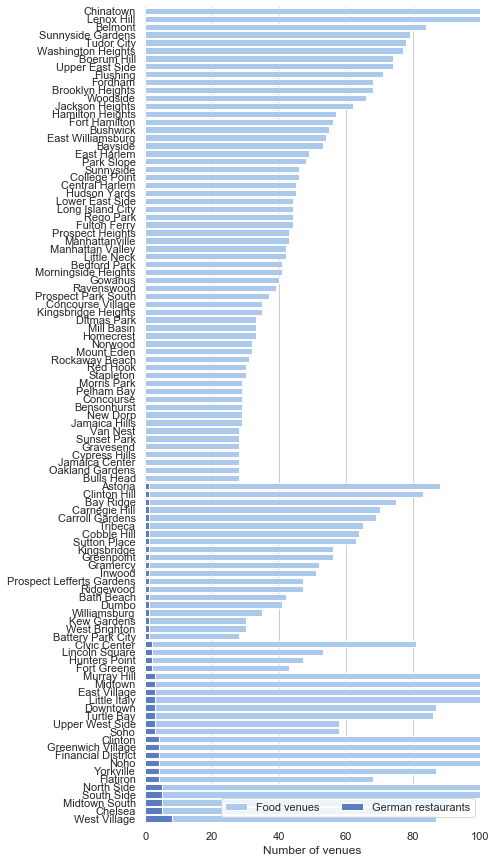

In [15]:
# Plot barchart 
sns.set(style="whitegrid")

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(6, 15))

# Plot the total of food venues
sns.set_color_codes("pastel")
sns.barplot(x="Food venues total", y="Neighborhood", data=df_results5,
            label="Food venues", color="b")

# Plot the german restaurants
sns.set_color_codes("muted")
sns.barplot(x="German restaurants", y="Neighborhood", data=df_results5,
            label="German restaurants", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 100), ylabel="",
       xlabel="Number of venues")
sns.despine(left=True, bottom=True)

The analysis shows that there are a lot of neighborhoods in New York that have a large number of food venues, indicating that there is a certain demand for food venues and restaurants in these areas while there is no German restaurant - at least no one that Foursquare would recommend based on the user tips. 


## Discussion of results
This analysis provides a list of areas with a high density of food venues and low number of German restaurants as a starting point for a further, more customer oriented analysis of the areas.

While this is this list and the maps are good starting point to look for ares with high potential for a German restaurant there are certain limitation due to the used dataset. The approach of looking for venues in a certai range around a given geo  may lead to incomplete lists of venues. Focussing only on recommended venues also may shorten the list. Nonetheless - if we aim for a restaurant with a great customer experience, low-rated restaurants nearby may be no real competition. 

Further research is needed to analyse the buying power and cultural orientation in the neighborhoods to find the perfect place for a new restaurant. Some of the neighborhoods that have no German restaurant may have none for a reason - from a naive perspective for example China Town may not be the first place to think about opening a German restaurant. 

## Conclusion
This test case led to some nice maps and already produced some good results. Real world use cases would probably work with clearer expectations towards the right spot for a new branch and allow to search more goal oriented. Also some of the limitations of the dataset may be corrected by adding additional resources into programming. 

Thank you for reviewing my work. I enjoyed the course but I also clearly see that way more training is necessary to get used to the Pyhton language and work way faster and more efficient.  






